<a href="https://colab.research.google.com/github/alheir/nnii-cv/blob/main/tp01_style_transfer.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

25.87 - Redes Neuronales II

> Computer Vision

TP1 - Neural Style Transfer

(referencia original: https://github.com/deeplearning-itba/cnn/blob/master/Trabajo_Final_CNN_Style_Transfer.ipynb)



Alumno: HEIR, Alejandro Nahuel

Legajo: 62496

e-mail: aheir@itba.edu.ar

# Style Transfer

<img src="https://i0.wp.com/chelseatroy.com/wp-content/uploads/2018/12/neural_style_transfer.png?resize=768%2C311&ssl=1">

La idea de este trabajo final es reproducir el siguiente paper:

https://arxiv.org/pdf/1508.06576.pdf

El objetivo es transferir el estilo de una imagen dada a otra imagen distinta.

Como hemos visto en clase, las primeras capas de una red convolucional se activan ante la presencia de ciertos patrones vinculados a detalles muy pequeños.

A medida que avanzamos en las distintas capas de una red neuronal convolucional, los filtros se van activando a medida que detectan patrones de formas cada vez mas complejos.

Lo que propone este paper es asignarle a la activación de las primeras capas de una red neuronal convolucional (por ejemplo VGG19) la definición del estilo y a la activación de las últimas capas de la red neuronal convolucional, la definición del contenido.

La idea de este paper es, a partir de dos imágenes (una que aporte el estilo y otra que aporte el contenido) analizar cómo es la activación de las primeras capas para la imagen que aporta el estilo y cómo es la activación de las últimas capas de la red convolucional para la imagen que aporta el contenido. A partir de esto se intentará sintetizar una imagen que active los filtros de las primeras capas que se activaron con la imagen que aporta el estilo y los filtros de las últimas capas que se activaron con la imagen que aporta el contenido.

A este procedimiento se lo denomina neural style transfer.

# En este trabajo se deberá leer el paper mencionado y en base a ello, entender la implementación que se muestra a continuación y contestar preguntas sobre la misma.

# Una metodología posible es hacer una lectura rápida del paper (aunque esto signifique no entender algunos detalles del mismo) y luego ir analizando el código y respondiendo las preguntas. A medida que se planteen las preguntas, volviendo a leer secciones específicas del paper terminará de entender los detalles que pudieran haber quedado pendientes.

Lo primero que haremos es cargar dos imágenes, una que aporte el estilo y otra que aporte el contenido. A tal fin utilizaremos imágenes disponibles en la web.

In [ ]:
# Imagen para estilo
!wget -q -nc https://upload.wikimedia.org/wikipedia/commons/5/52/La_noche_estrellada1.jpg

# Imagen para contenido
!wget -q -nc https://upload.wikimedia.org/wikipedia/commons/thumb/f/f4/Neckarfront_T%C3%BCbingen_Mai_2017.jpg/775px-Neckarfront_T%C3%BCbingen_Mai_2017.jpg

# Creamos el directorio para los archivos de salida
!mkdir -p /content/output

In [ ]:
!pip uninstall tensorflow -y --quiet
!pip install tensorflow==2.8.0 --quiet

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
tf-keras 2.17.0 requires tensorflow<2.18,>=2.17, but you have tensorflow 2.8.0 which is incompatible.


In [ ]:
from tensorflow.python.framework.ops import disable_eager_execution
disable_eager_execution()

In [ ]:
import tensorflow as tf
from tensorflow.keras.preprocessing.image import load_img, save_img, img_to_array
import numpy as np
from scipy.optimize import fmin_l_bfgs_b
import time
import argparse

from tensorflow.keras.applications import vgg19
from tensorflow.keras import backend as K
from pathlib import Path

import matplotlib.pyplot as plt
import matplotlib.image as mpimg

In [ ]:
# Definimos las imagenes que vamos a utilizar, y el directorio de salida

base_image_path = Path("/content/775px-Neckarfront_Tübingen_Mai_2017.jpg")
style_reference_image_path = Path("/content/La_noche_estrellada1.jpg")
result_prefix = Path("/content/output")

# 1) En base a lo visto en el paper ¿Qué significan los parámetros definidos en la siguiente celda?

Respuesta:

`content_weight` y `style_weight` refieren a los pesos $\alpha$ y $\beta$, respectivamente, de la función de pérdida que se minimiza en el algoritmo propuesto (eq. 7). $\alpha$ refiere al peso que se le da, en la reconstrucción-transferencia, al contenido de la imagen original, mientras que $\beta$ refiere al que se le da al estilo de referencia. Un mayor $\beta$ introducirá un estilo más similar al pretendido, perdiendo detalles del contenido original.

Por otro lado, `total_variation_weight` pondera la función de pérdida para garantizar que la imagen generada sea suave y continua, evitando la aparición de artefactos y ruido indeseado. Un valor alto dará lugar a una imagen más suave, mientras que un valor bajo permitirá más detalles, pero podría introducir ruido o discontinuidades.

En resumen:
* `content_weight` ($\alpha$) controla cuánto de la estructura y detalles de la imagen original se preserva.
* `style_weight` ($\beta$) define cuánto del estilo de la imagen de referencia se transfiere.
* `total_variation_weight` regula la suavidad de la imagen final, evitando que se generen artefactos no deseados.


In [ ]:
total_variation_weight = 0.1
style_weight = 10
content_weight = 1

In [ ]:
# Definimos el tamaño de las imágenes a utilizar
width, height = load_img(base_image_path).size
img_nrows = 200
img_ncols = int(width * img_nrows / height)

# 2) Explicar qué hace la siguiente celda. En especial las últimas dos líneas de la función antes del return. ¿Por qué?

Ayuda: https://keras.io/applications/

Respuesta:

`preprocess_image` toma el path de una imagen, la redimensiona a `img_nrows` x `img_ncols`, la transforma a un numpy array 3D (una dimensión por canal) y la preprocesa para usarla con red VGG19.

`np.expand_dims(img, axis=0)` le agrega una dimensión al array, quedando con la forma `(1, <alto>, <ancho>, <canales>)`, para "elevar" el formato a tensor, quedando un batch de una sola imagen (las redes suelen procesan en batches).

`vgg19.preprocess_input(img)` acondiciona la imagen con cambios de color e intensidades acordes a las imágenes de entrenamiento que tuvo la VGG19 instanciada, con tal de maximizar los resultados obtenidos.

<img alt="" src="https://i.imgur.com/EjwHBxv.png" original-title="">

In [ ]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

# 3) Habiendo comprendido lo que hace la celda anterior, explique de manera muy concisa qué hace la siguiente celda. ¿Qué relación tiene con la celda anterior?

Respuesta:

`deprocess_image` aplica la transformación inversa de `preprocess_image`.

1. Redimensiona a `(<alto>, <ancho>, <canales>)`
2. Revierte el acondicionamiento particular de VGG19; valores ya predefinidos/hardcodeados.
3. Permuta los canales, para pasar de BGR a RGB (VGG19 necesita formato BGR)
4. Fuerza valores `uint8` (0 a 255)

In [ ]:
def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

In [ ]:
# get tensor representations of our images
# K.variable convierte un numpy array en un tensor, para
base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

In [ ]:
combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

Aclaración:

La siguiente celda sirve para procesar las tres imagenes (contenido, estilo y salida) en un solo batch.

In [ ]:
# combine the 3 images into a single Keras tensor
input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

In [ ]:
# build the VGG19 network with our 3 images as input
# the model will be loaded with pre-trained ImageNet weights
model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

# get the symbolic outputs of each "key" layer (we gave them unique names).
outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

Model loaded.


# 4) En la siguientes celdas:

- ¿Qué es la matriz de Gram? ¿Para qué se usa?
- ¿Por qué se permutan las dimensiones de x?

La matriz de Gram captura las **correlaciones** entre los diferentes canales de una capa de características de una CNN. En el contexto destyle transfer, la matriz de Gram de una imagen representa la información de las texturas o el "estilo". En la loss de estilo, se compara la matriz de Gram de la imagen generada con la matriz de Gram de la imagen de estilo, para medir qué tan similar es el estilo entre ambas

Se permutan las dimensiones de x con `K.permute_dimensions(x, (2, 0, 1))` para reorganizar los ejes de manera que el canal de color sea la primera dimensión y luego las dimensiones espaciales (alto y ancho). Esto facilita el cálculo de la matriz de Gram, ya que lo que nos interesa es la relación entre los diferentes canales de color, y el cálculo del producto de matrices se hace sobre estos.

In [ ]:
def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

# 5) Losses:

Explicar qué mide cada una de las losses en las siguientes tres celdas.

Rta:

* `style_loss(style, combination)` mide la diferencia entre la matriz de Gram de la imagen de estilo y la imagen generada. Refleja qué tan bien la imagen generada ha capturado el estilo (patrones y texturas) de la imagen de referencia de estilo. Se normaliza dividiendo por el tamaño de la imagen y el número de canales.
* `content_loss(base, combination)` la diferencia entre las características de contenido (capas profundas de la red convolucional) de la imagen base y la imagen generada. Refleja qué tan bien la imagen generada preserva la estructura y los detalles de la imagen base.
* `total_variation_loss(x)` penaliza grandes variaciones entre píxeles adyacentes en la imagen generada. Al minimizarla, se obtiene una imagen más suave y coherente, evitando la aparición de artefactos y ruido indeseado.



In [ ]:
def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

In [ ]:
def content_loss(base, combination):
    return K.sum(K.square(combination - base))


In [ ]:
def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))


In [ ]:
# Armamos la loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

In [ ]:
grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

# 6) Explique el propósito de las siguientes tres celdas. ¿Qué hace la función fmin_l_bfgs_b? ¿En qué se diferencia con la implementación del paper? ¿Se puede utilizar alguna alternativa?

Respuesta:

Las celdas realizan el proceso de optimización para generar la imagen estilizada a partir de la de contenido y la de referencia, utilizando el algoritmo `L-BFGS-B`, *Limited-memory Broyden–Fletcher–Goldfarb–Shanno with Box constraints*, que es un método de optimización numérica que busca minimizar una función objetivo bajo ciertas restricciones (como límites en los valores de los parámetros).

El propósito es minimizar la "pérdida de estilo neural" (neural style loss) aplicando este método de optimización a los píxeles de la imagen generada.

Sobre la clase `Evaluator`: *comentado*

`fmin_l_bfgs_b` es una función de `scipy.optimize` que implementa el algoritmo `L-BFGS-B`. Minimiza la neural style loss calculada en la clase Evaluator ajustando los píxeles de la imagen generada para hacer que esta se asemeje más a la combinación deseada de la imagen de contenido y la de estilo.

Sí, se diferencia de la implementación del paper. En el paper, se usa el método `L-BFGS`, que no tiene box contraints, no permitiendo limitar valores de los parámetros dentro de un rango específico. `L-BFGS-B` permite restringir los píxeles de la imagen entre 0 y 255 (por ejemplo).
* https://machinelearningmastery.com/bfgs-optimization-in-python/

Como alternativa a `L-BFGS-B`, se pueden podría plantear utilizar optimizadores como Adam, SGD o RMSProp, pero `L-BFGS-B` se presenta como el más adecuado para optimización en campos de generación de imágenes:
* https://stats.stackexchange.com/questions/315626/the-reason-of-superiority-of-limited-memory-bfgs-over-adam-solver
* `L-BFGS-B` ~ Adam >> GD, Adadelta, RMSProp https://blog.slavv.com/picking-an-optimizer-for-style-transfer-86e7b8cba84b

In [ ]:
def eval_loss_and_grads(x):
    x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

# this Evaluator class makes it possible
# to compute loss and gradients in one pass
# while retrieving them via two separate functions,
# "loss" and "grads". This is done because scipy.optimize
# requires separate functions for loss and gradients,
# but computing them separately would be inefficient.

In [ ]:
class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

# 7) Ejecute la siguiente celda y observe las imágenes de salida en cada iteración.



```
# Disclaimer

Dado el tiempo de cómputo de fmin_l_bfgs_b, tuve que reducir
las dimensiones de procesamiento a img_nrows=200 y
limitar a 10 iteraciones
```



In [ ]:
evaluator = Evaluator()

# run scipy-based optimization (L-BFGS) over the pixels of the generated image
# so as to minimize the neural style loss
x = preprocess_image(base_image_path)

iterations = 10

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / ('output_at_iteration_%d.png' % i)
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 17845895000.0
Image saved as /content/output/output_at_iteration_0.png
Iteration 0 completed in 143s
Start of iteration 1
Current loss value: 7954776600.0
Image saved as /content/output/output_at_iteration_1.png
Iteration 1 completed in 116s
Start of iteration 2
Current loss value: 5463313000.0
Image saved as /content/output/output_at_iteration_2.png
Iteration 2 completed in 114s
Start of iteration 3
Current loss value: 4253847300.0
Image saved as /content/output/output_at_iteration_3.png
Iteration 3 completed in 114s
Start of iteration 4
Current loss value: 3601505000.0
Image saved as /content/output/output_at_iteration_4.png
Iteration 4 completed in 122s
Start of iteration 5
Current loss value: 3176244200.0
Image saved as /content/output/output_at_iteration_5.png
Iteration 5 completed in 113s
Start of iteration 6
Current loss value: 2850010000.0
Image saved as /content/output/output_at_iteration_6.png
Iteration 6 completed in 130s
Start of ite

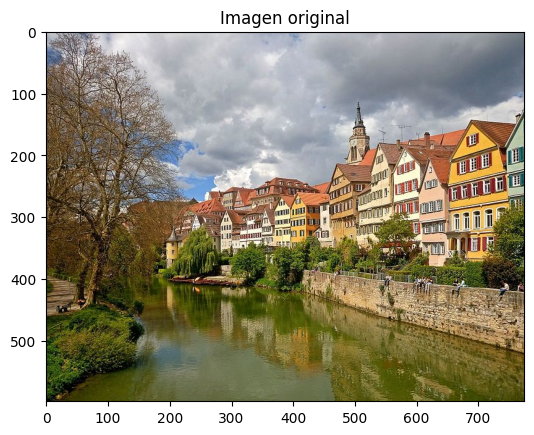

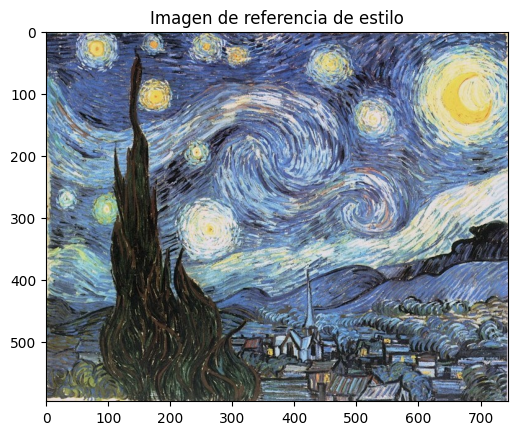

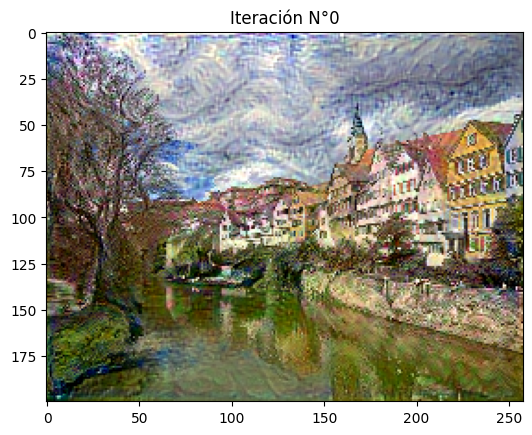

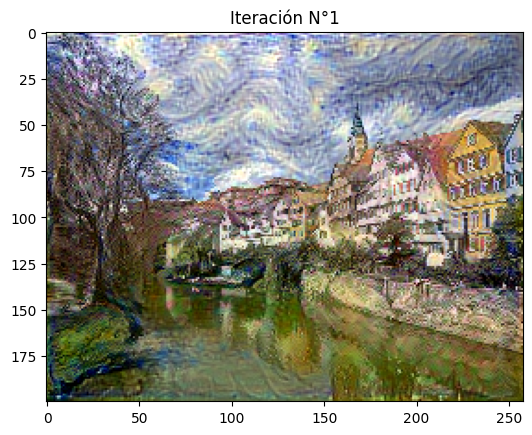

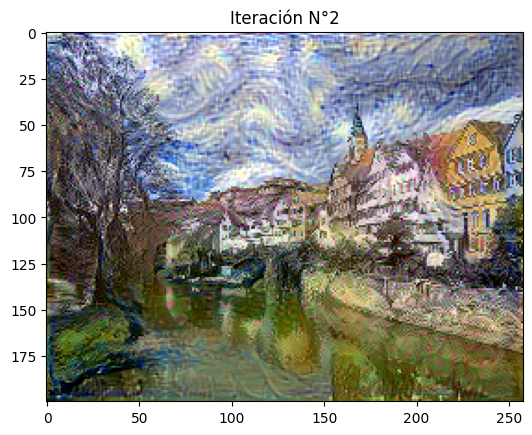

...

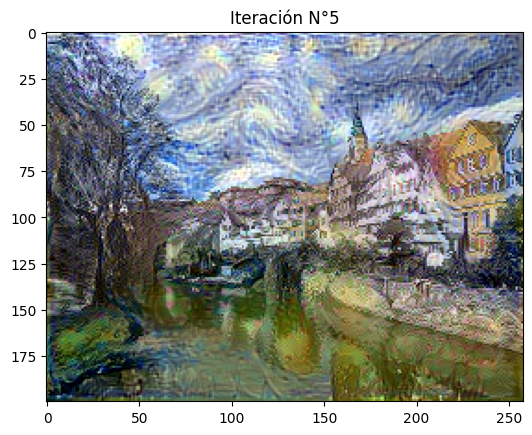

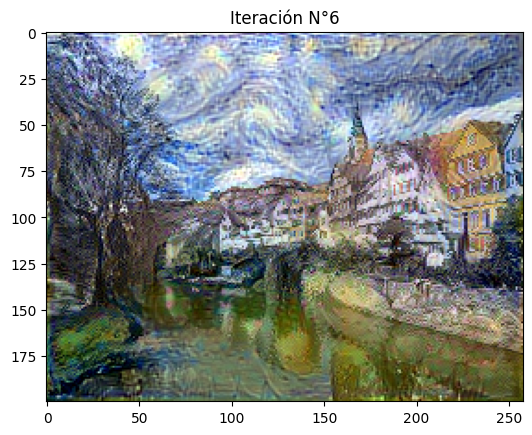

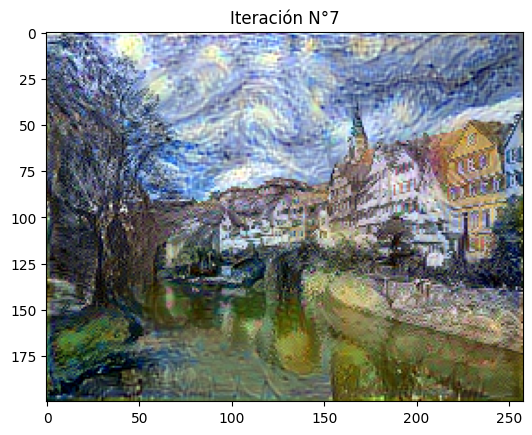

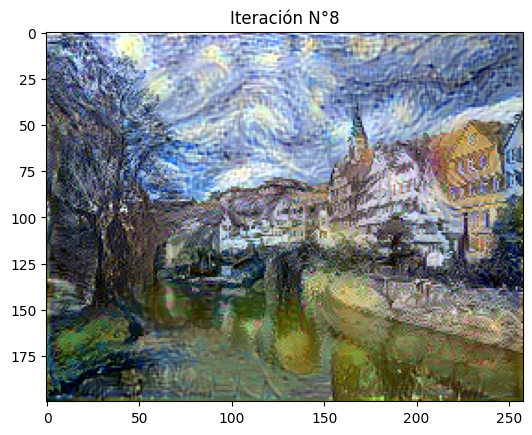

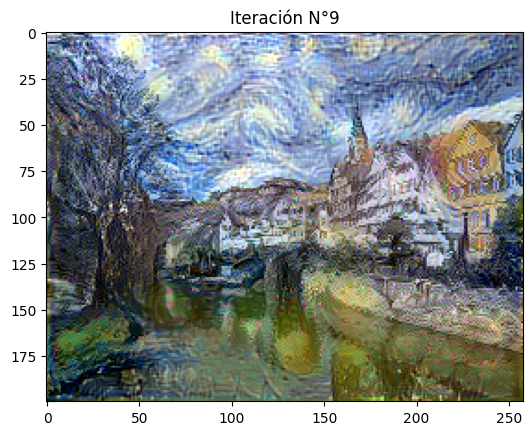

In [ ]:
# original
img_original = mpimg.imread('/content/775px-Neckarfront_Tübingen_Mai_2017.jpg')
plt.imshow(img_original)
plt.title("Imagen original")
plt.show()

# referencia
img_style = mpimg.imread('/content/La_noche_estrellada1.jpg')
plt.imshow(img_style)
plt.title("Imagen de referencia de estilo")
plt.show()

for i in range(iterations):
  img_output = mpimg.imread(str(result_prefix / ('output_at_iteration_%d.png' % i)))
  plt.imshow(img_output)
  plt.title(f"Iteración N°{i}")
  plt.show()


# 8) Generar imágenes para distintas combinaciones de pesos de las losses. Explicar las diferencias. (Adjuntar las imágenes generadas como archivos separados.)

Respuesta:



Pesos originales:
```
total_variation_weight = 0.1
style_weight = 10
content_weight = 1
```

## Iteraciones

In [ ]:
iterations = 5

combinations = [
    # {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 0.1}, # pesos originales
    {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 0.1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 1},
]

for combination_index, combination in enumerate(combinations):
    print(f"--- Combination {combination_index + 1} ---")
    content_weight = combination['content_weight']
    style_weight = combination['style_weight']
    total_variation_weight = combination['total_variation_weight']

    loss = K.variable(0.0)
    layer_features = outputs_dict['block5_conv2']
    base_image_features = layer_features[0, :, :, :]
    combination_features = layer_features[2, :, :, :]
    loss = loss + content_weight * content_loss(base_image_features,
                                                combination_features)

    feature_layers = ['block1_conv1', 'block2_conv1',
                      'block3_conv1', 'block4_conv1',
                      'block5_conv1']
    for layer_name in feature_layers:
        layer_features = outputs_dict[layer_name]
        style_reference_features = layer_features[1, :, :, :]
        combination_features = layer_features[2, :, :, :]
        sl = style_loss(style_reference_features, combination_features)
        loss = loss + (style_weight / len(feature_layers)) * sl
    loss = loss + total_variation_weight * total_variation_loss(combination_image)
    grads = K.gradients(loss, combination_image)

    outputs = [loss]
    if isinstance(grads, (list, tuple)):
        outputs += grads
    else:
        outputs.append(grads)

    f_outputs = K.function([combination_image], outputs)
    evaluator = Evaluator()

    x = preprocess_image(base_image_path)

    for i in range(iterations):
        print('Start of iteration', i)
        start_time = time.time()
        x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                         fprime=evaluator.grads, maxfun=20)
        print('Current loss value:', min_val)
        img = deprocess_image(x.copy())
        fname = result_prefix / (f'output_combination_{combination_index + 1}_iteration_{i}.png')
        save_img(fname, img)
        end_time = time.time()
        print('Image saved as', fname)
        print('Iteration %d completed in %ds' % (i, end_time - start_time))



--- Combination 1 ---
Start of iteration 0
Current loss value: 21418803000.0
Image saved as /content/output/output_combination_1_iteration_0.png
Iteration 0 completed in 120s
Start of iteration 1
Current loss value: 10843388000.0
Image saved as /content/output/output_combination_1_iteration_1.png
Iteration 1 completed in 120s
Start of iteration 2
Current loss value: 7788858400.0
Image saved as /content/output/output_combination_1_iteration_2.png
Iteration 2 completed in 115s
Start of iteration 3
Current loss value: 6104897500.0
Image saved as /content/output/output_combination_1_iteration_3.png
Iteration 3 completed in 120s
Start of iteration 4
Current loss value: 5199721500.0
Image saved as /content/output/output_combination_1_iteration_4.png
Iteration 4 completed in 115s
--- Combination 2 ---
Start of iteration 0
Current loss value: 3637716000.0
Image saved as /content/output/output_combination_2_iteration_0.png
Iteration 0 completed in 116s
Start of iteration 1
Current loss value: 2

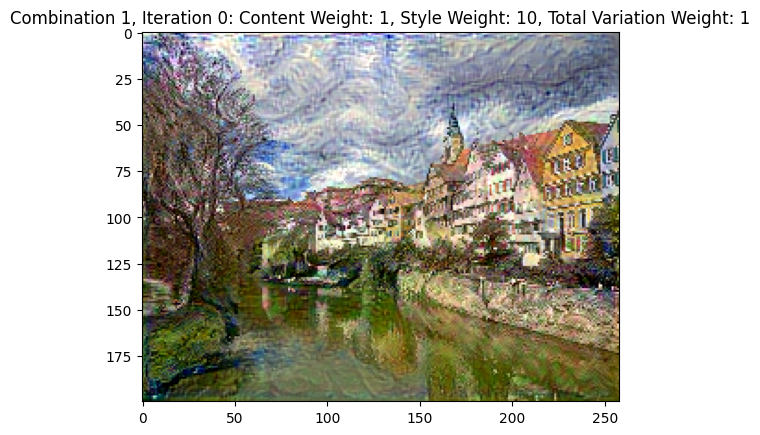

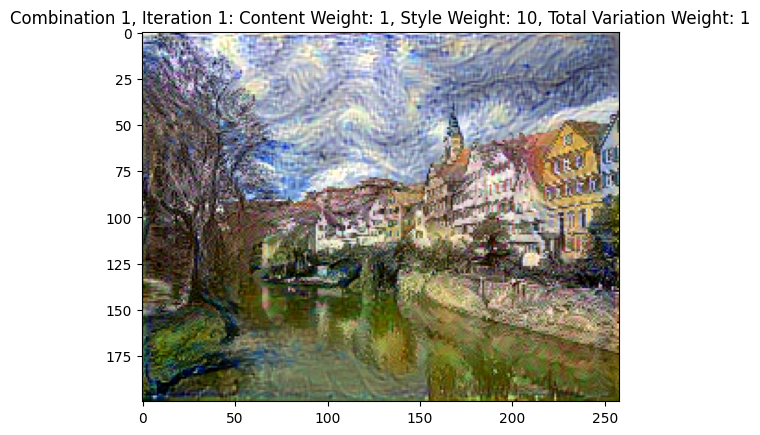

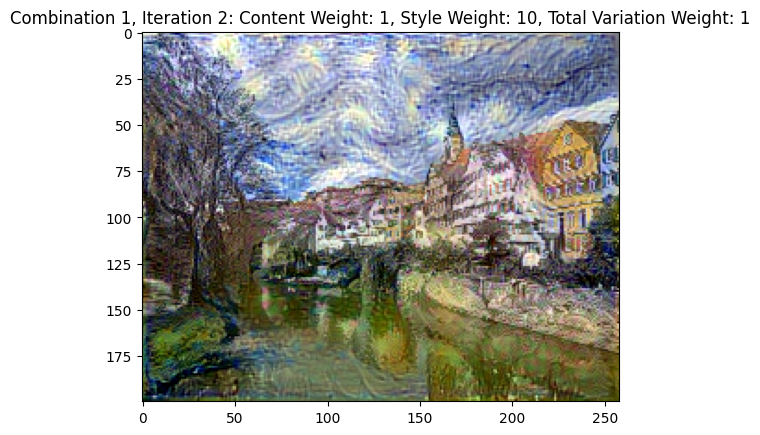

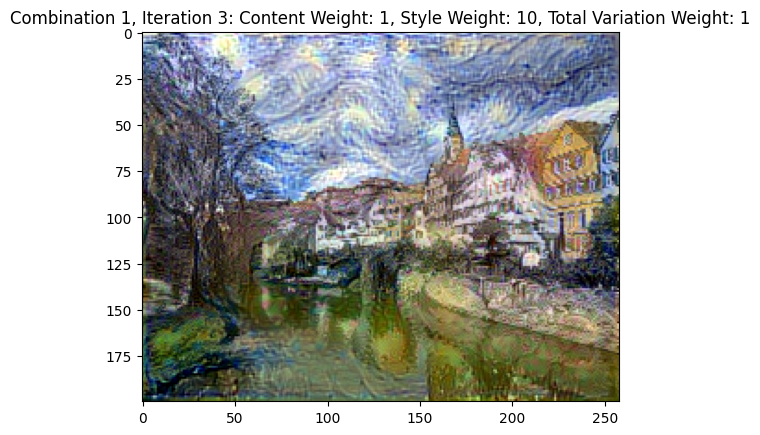

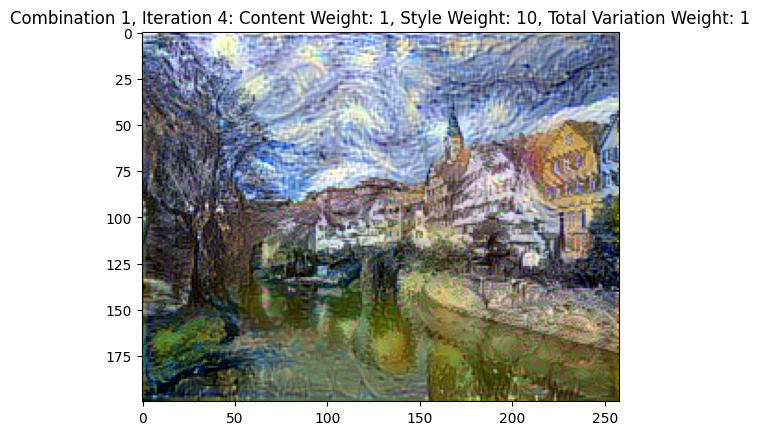

...

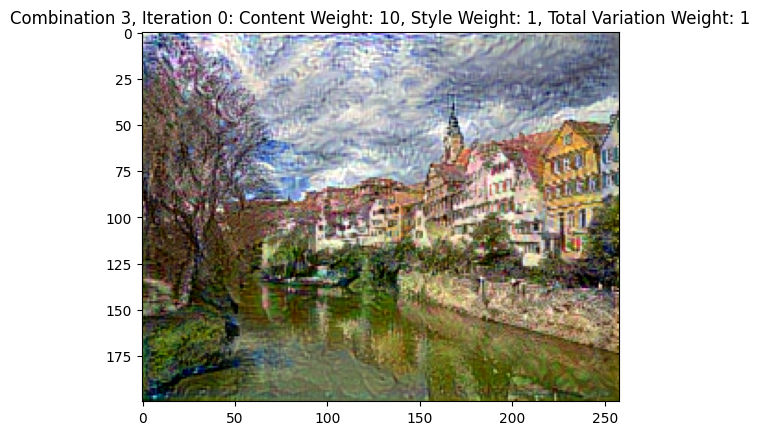

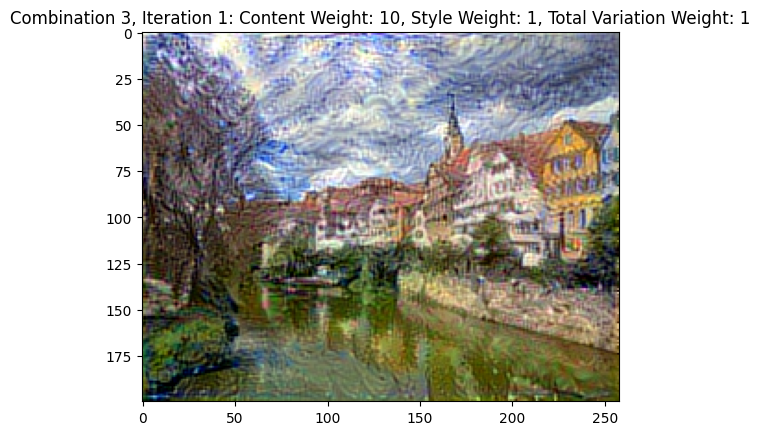

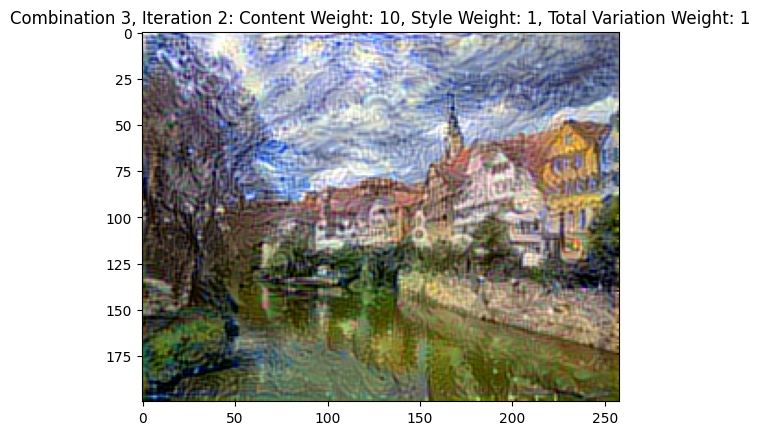

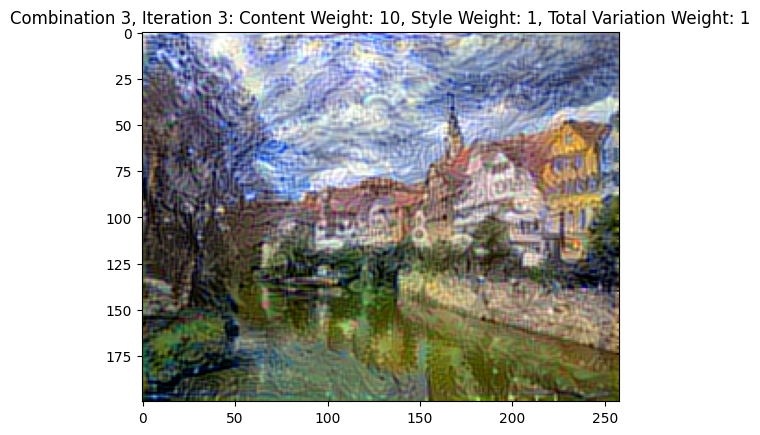

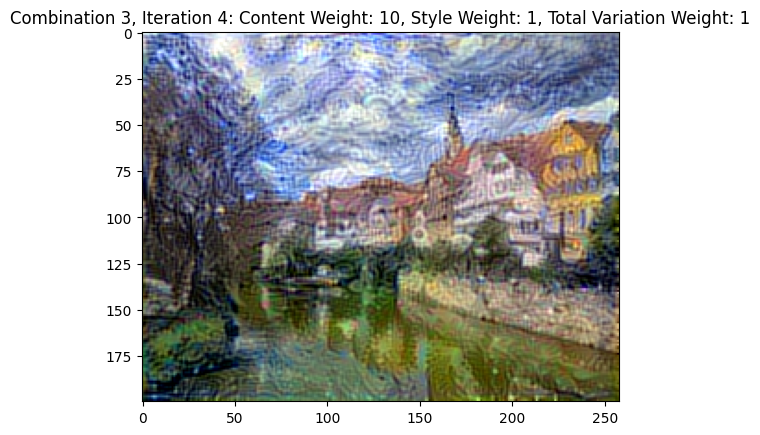

In [ ]:
for combination_index, combination in enumerate(combinations):
  for i in range(iterations):
    img_output = mpimg.imread(str(result_prefix / (f'output_combination_{combination_index + 1}_iteration_{i}.png')))
    plt.imshow(img_output)
    title = f"Combination {combination_index + 1}, Iteration {i}: "
    title += f"Content Weight: {combination['content_weight']}, "
    title += f"Style Weight: {combination['style_weight']}, "
    title += f"Total Variation Weight: {combination['total_variation_weight']}"
    plt.title(title)
    plt.show()

## Diferencias

Combinación 1: más `total_variation_weight`
* Similar a la iteración original, pero menos suave / mas ruidosa.

Combinación 2: más `content_weight`
* Si bien se aprecia el estilo objetivo, se conservan más los detalles del contenido original, comparando con las iteraciones anteriores. Se destaca en los frentes de los edificiones más cercanos (la textura), además de seguir identificándose los edificiones lejanos.

Combinación 3: más `content_weight` con más `total_variation_weight`
* Se obtiene un efecto de granularidad/ruido sobre la combinación anterior, sin acentuar las deformaciones hacia el estilo.

```
combinations = [
    # {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 0.1}, # pesos originales
    {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 0.1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 1},
]
```

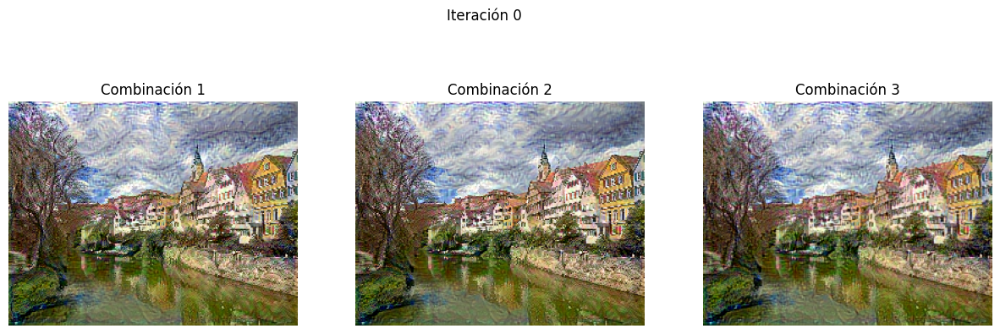

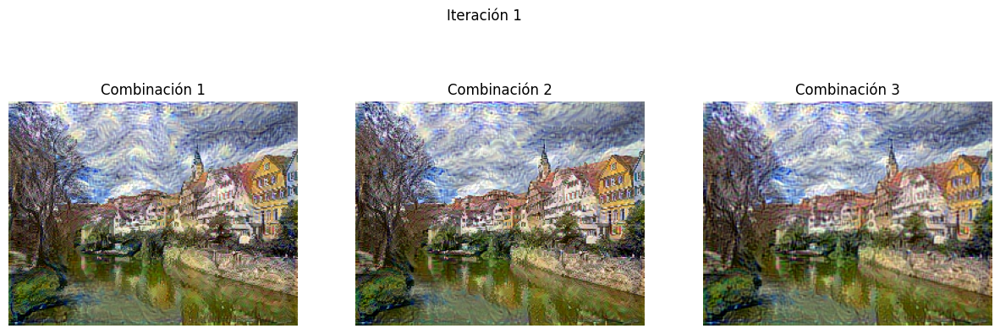

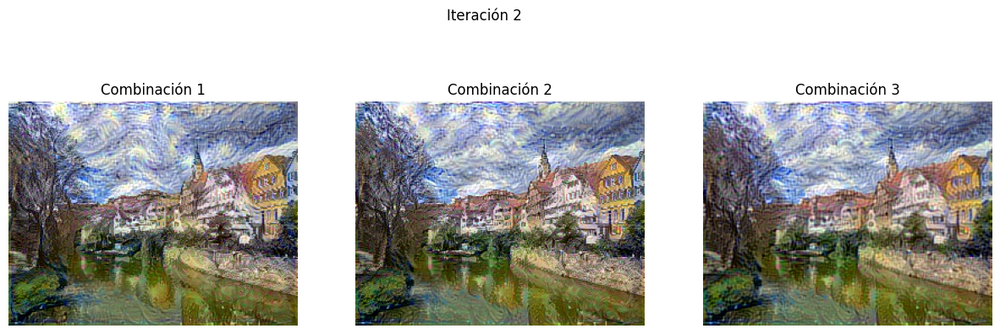

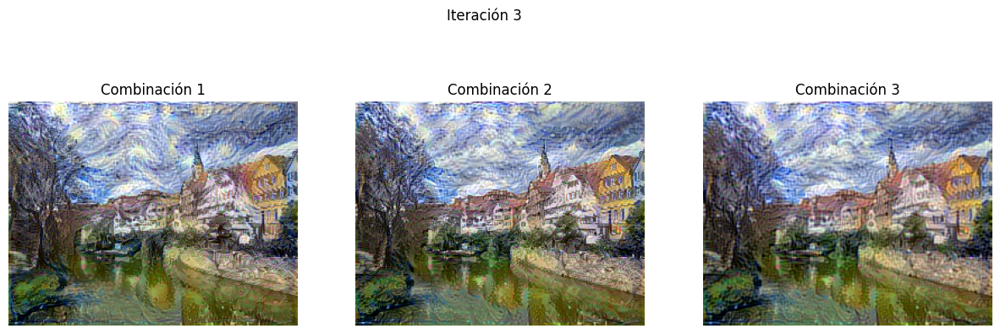

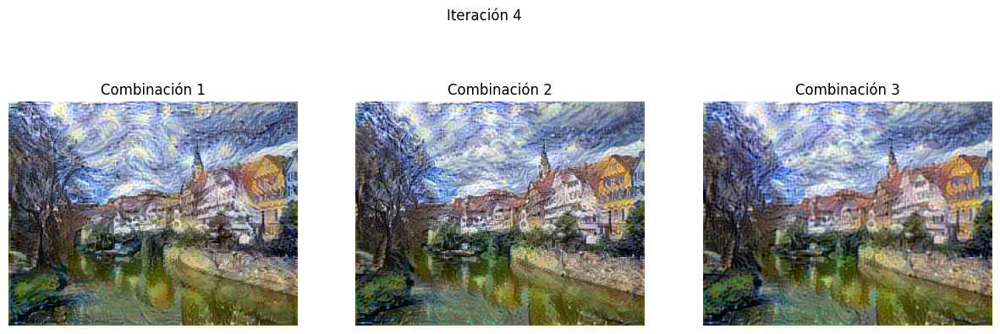

In [ ]:
for i in range(iterations):
    fig, axes = plt.subplots(1, 3, figsize=(15, 5))
    fig.suptitle(f"Iteración {i}")

    for combination_index, combination in enumerate(combinations):
        img_output = mpimg.imread(str(result_prefix / (f'output_combination_{combination_index + 1}_iteration_{i}.png')))
        axes[combination_index].imshow(img_output)
        axes[combination_index].set_title(f"Combinación {combination_index + 1}")
        axes[combination_index].axis('off')

    plt.show()

combinations = [
    # {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 0.1}, # pesos originales
    {'content_weight': 1, 'style_weight': 10, 'total_variation_weight': 1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 0.1},
    {'content_weight': 10, 'style_weight': 1, 'total_variation_weight': 1},
]

# 9) Cambiar las imágenes de contenido y estilo por unas elegidas por usted. Adjuntar el resultado.

Respuesta:

## a) Dali y vacas

In [ ]:
# estilo
!wget -q -nc -O "relojes.jpg" https://media.gq.com.mx/photos/5eb98f9a51cd5e1b340e8d48/master/w_1600,c_limit/la-persistencia-de-la-memoria-de-salvador-dali-significado-foto.jpg

# contenido
!wget -q -nc -O "vacas.jpg" https://img.freepik.com/fotos-premium/grupo-vacas-estan-pastando-campo-arboles-fondo_728472-6986.jpg

# directorio para los archivos de salida
!mkdir -p /content/output_a

Referencia:

<img src="https://media.gq.com.mx/photos/5eb98f9a51cd5e1b340e8d48/master/w_1600,c_limit/la-persistencia-de-la-memoria-de-salvador-dali-significado-foto.jpg">

Contenido:

<img src="https://img.freepik.com/fotos-premium/grupo-vacas-estan-pastando-campo-arboles-fondo_728472-6986.jpg">

In [ ]:
base_image_path = Path("/content/vacas.jpg")
style_reference_image_path = Path("/content/relojes.jpg")
result_prefix = Path("/content/output_a")

total_variation_weight = 0.1
style_weight = 10
content_weight = 1

width, height = load_img(base_image_path).size
img_nrows = 200
img_ncols = int(width * img_nrows / height)

### Redefiniciones

In [ ]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

def content_loss(base, combination):
    return K.sum(K.square(combination - base))

def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

# loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

def eval_loss_and_grads(x):
    x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

Model loaded.


### Procesamiento

In [ ]:
evaluator = Evaluator()

x = preprocess_image(base_image_path)

iterations = 10

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / ('output_at_iteration_%d.png' % i)
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 22685217000.0
Image saved as /content/output_a/output_at_iteration_0.png
Iteration 0 completed in 135s
Start of iteration 1
Current loss value: 10191835000.0
Image saved as /content/output_a/output_at_iteration_1.png
Iteration 1 completed in 128s
Start of iteration 2
Current loss value: 7088332300.0
Image saved as /content/output_a/output_at_iteration_2.png
Iteration 2 completed in 121s
Start of iteration 3
Current loss value: 5744194000.0
Image saved as /content/output_a/output_at_iteration_3.png
Iteration 3 completed in 126s
Start of iteration 4
Current loss value: 5092939300.0
Image saved as /content/output_a/output_at_iteration_4.png
Iteration 4 completed in 126s
Start of iteration 5
Current loss value: 4595535000.0
Image saved as /content/output_a/output_at_iteration_5.png
Iteration 5 completed in 127s
Start of iteration 6
Current loss value: 4243387400.0
Image saved as /content/output_a/output_at_iteration_6.png
Iteration 6 completed in 14

### Resultados

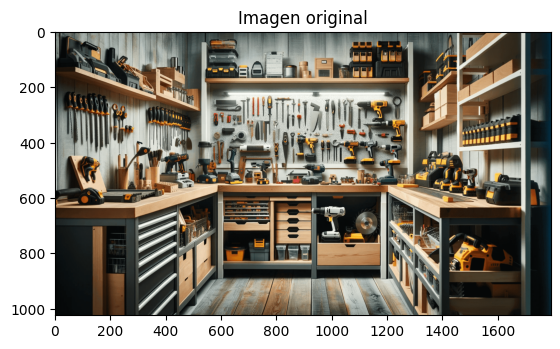

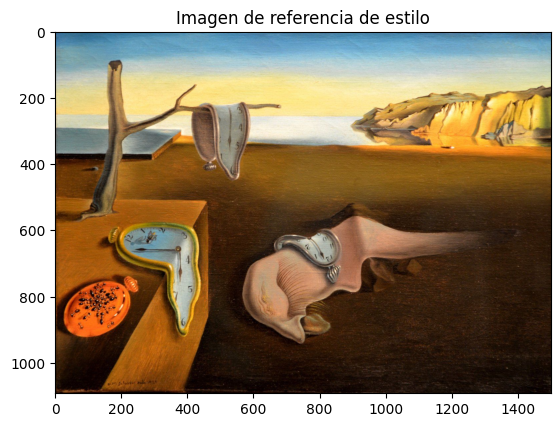

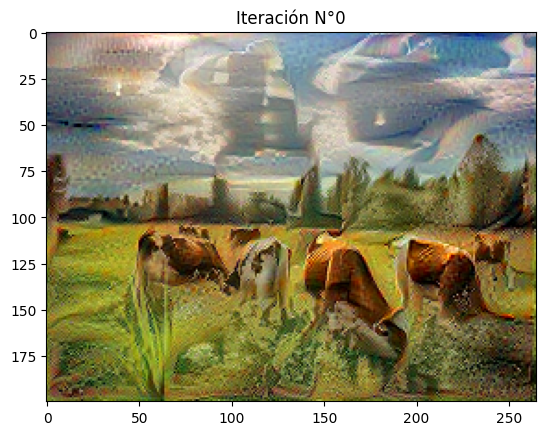

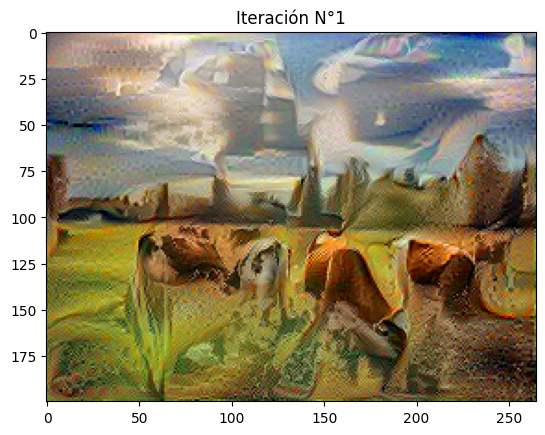

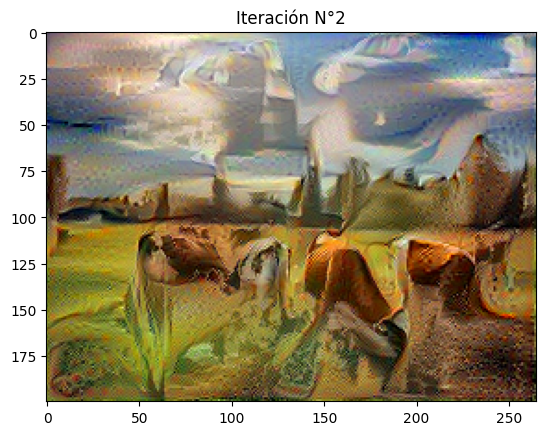

...

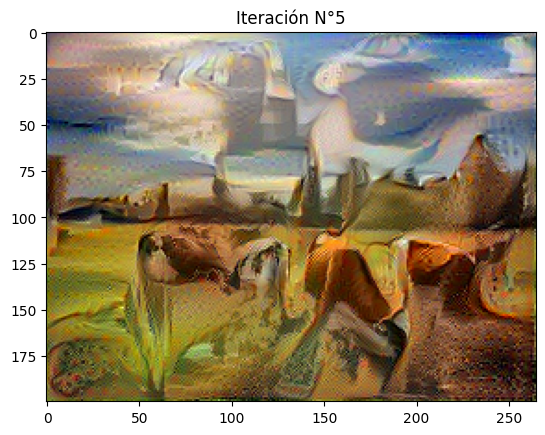

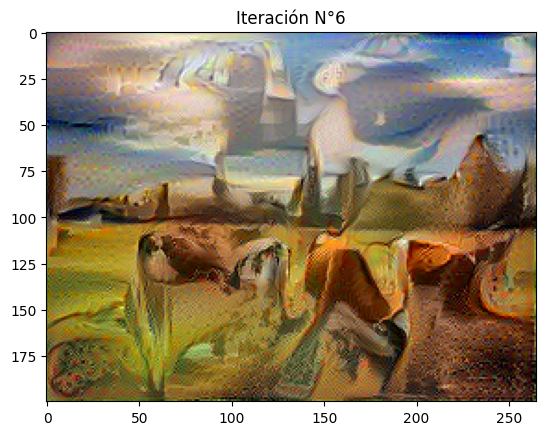

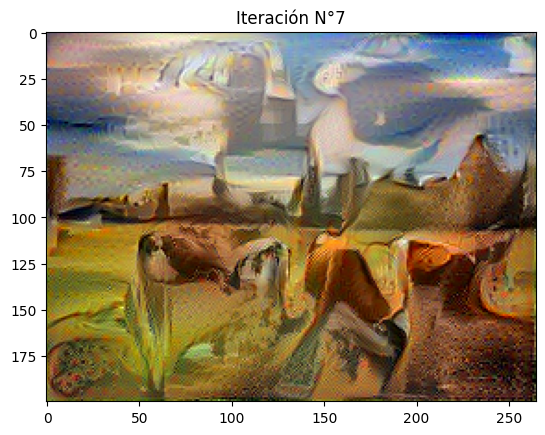

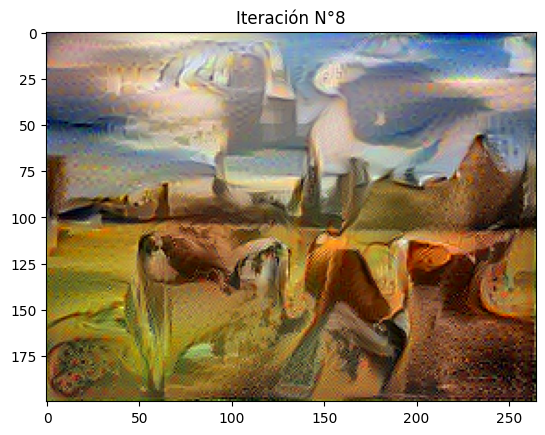

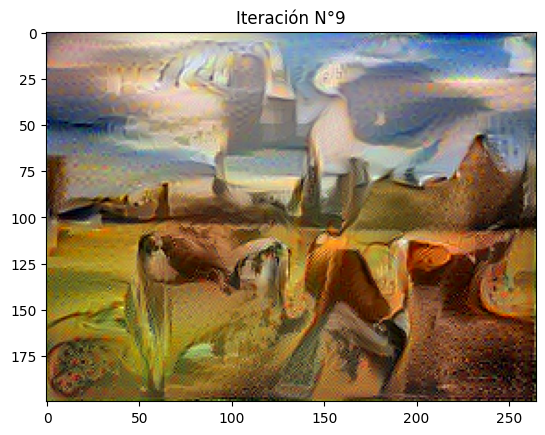

In [ ]:
# original
img_original = mpimg.imread('/content/vacas.jpg')
plt.imshow(img_original)
plt.title("Imagen original")
plt.show()

# referencia
img_style = mpimg.imread('/content/relojes.jpg')
plt.imshow(img_style)
plt.title("Imagen de referencia de estilo")
plt.show()

for i in range(iterations):
  img_output = mpimg.imread(str(result_prefix / ('output_at_iteration_%d.png' % i)))
  plt.imshow(img_output)
  plt.title(f"Iteración N°{i}")
  plt.show()

## b) Futurismo y pulseada

In [ ]:
# estilo
!wget -q -nc -O "futurismo.jpg" https://uploads4.wikiart.org/images/umberto-boccioni/simultaneous-visions-1912.jpg!Large.jpg

# contenido
!wget -q -nc -O "pulseada.jpg" https://telefe-static2.akamaized.net/media/309789/pulseada.jpg

# directorio para los archivos de salida
!mkdir -p /content/output_b

Referencia:

<img src="https://uploads4.wikiart.org/images/umberto-boccioni/simultaneous-visions-1912.jpg!Large.jpg">

Contenido:

<img src="https://telefe-static2.akamaized.net/media/309789/pulseada.jpg">

### Redefiniciones

In [ ]:
base_image_path = Path("/content/pulseada.jpg")
style_reference_image_path = Path("/content/futurismo.jpg")
result_prefix = Path("/content/output_b")

total_variation_weight = 0.1
style_weight = 10
content_weight = 1

width, height = load_img(base_image_path).size
img_nrows = 200
img_ncols = int(width * img_nrows / height)

In [ ]:
def preprocess_image(image_path):
    img = load_img(image_path, target_size=(img_nrows, img_ncols))
    img = img_to_array(img)
    img = np.expand_dims(img, axis=0)
    img = vgg19.preprocess_input(img)
    return img

def deprocess_image(x):
    x = x.reshape((img_nrows, img_ncols, 3))
    # Remove zero-center by mean pixel
    x[:, :, 0] += 103.939
    x[:, :, 1] += 116.779
    x[:, :, 2] += 123.68
    # 'BGR'->'RGB'
    x = x[:, :, ::-1]
    x = np.clip(x, 0, 255).astype('uint8')
    return x

base_image = K.variable(preprocess_image(base_image_path))
style_reference_image = K.variable(preprocess_image(style_reference_image_path))

combination_image = K.placeholder((1, img_nrows, img_ncols, 3))

input_tensor = K.concatenate([base_image,
                              style_reference_image,
                              combination_image], axis=0)

model = vgg19.VGG19(input_tensor=input_tensor,
                    weights='imagenet', include_top=False)
print('Model loaded.')

outputs_dict = dict([(layer.name, layer.output) for layer in model.layers])

def gram_matrix(x):
    features = K.batch_flatten(K.permute_dimensions(x, (2, 0, 1)))
    gram = K.dot(features, K.transpose(features))
    return gram

def style_loss(style, combination):
    assert K.ndim(style) == 3
    assert K.ndim(combination) == 3
    S = gram_matrix(style)
    C = gram_matrix(combination)
    channels = 3
    size = img_nrows * img_ncols
    return K.sum(K.square(S - C)) / (4.0 * (channels ** 2) * (size ** 2))

def content_loss(base, combination):
    return K.sum(K.square(combination - base))

def total_variation_loss(x):
    assert K.ndim(x) == 4
    a = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, 1:, :img_ncols - 1, :])
    b = K.square(
        x[:, :img_nrows - 1, :img_ncols - 1, :] - x[:, :img_nrows - 1, 1:, :])
    return K.sum(K.pow(a + b, 1.25))

# loss total
loss = K.variable(0.0)
layer_features = outputs_dict['block5_conv2']
base_image_features = layer_features[0, :, :, :]
combination_features = layer_features[2, :, :, :]
loss = loss + content_weight * content_loss(base_image_features,
                                            combination_features)

feature_layers = ['block1_conv1', 'block2_conv1',
                  'block3_conv1', 'block4_conv1',
                  'block5_conv1']
for layer_name in feature_layers:
    layer_features = outputs_dict[layer_name]
    style_reference_features = layer_features[1, :, :, :]
    combination_features = layer_features[2, :, :, :]
    sl = style_loss(style_reference_features, combination_features)
    loss = loss + (style_weight / len(feature_layers)) * sl
loss = loss + total_variation_weight * total_variation_loss(combination_image)

grads = K.gradients(loss, combination_image)

outputs = [loss]
if isinstance(grads, (list, tuple)):
    outputs += grads
else:
    outputs.append(grads)

f_outputs = K.function([combination_image], outputs)

def eval_loss_and_grads(x):
    x = x.reshape((1, img_nrows, img_ncols, 3))
    outs = f_outputs([x])
    loss_value = outs[0]
    if len(outs[1:]) == 1:
        grad_values = outs[1].flatten().astype('float64')
    else:
        grad_values = np.array(outs[1:]).flatten().astype('float64')
    return loss_value, grad_values

class Evaluator(object):

    def __init__(self):
        self.loss_value = None
        self.grads_values = None

    def loss(self, x):
        assert self.loss_value is None
        loss_value, grad_values = eval_loss_and_grads(x)
        self.loss_value = loss_value
        self.grad_values = grad_values
        return self.loss_value

    def grads(self, x):
        assert self.loss_value is not None
        grad_values = np.copy(self.grad_values)
        self.loss_value = None
        self.grad_values = None
        return grad_values

Model loaded.


### Procesamiento

In [ ]:
evaluator = Evaluator()

x = preprocess_image(base_image_path)

iterations = 10

for i in range(iterations):
    print('Start of iteration', i)
    start_time = time.time()
    x, min_val, info = fmin_l_bfgs_b(evaluator.loss, x.flatten(),
                                     fprime=evaluator.grads, maxfun=20)
    print('Current loss value:', min_val)
    # save current generated image
    img = deprocess_image(x.copy())
    fname = result_prefix / ('output_at_iteration_%d.png' % i)
    save_img(fname, img)
    end_time = time.time()
    print('Image saved as', fname)
    print('Iteration %d completed in %ds' % (i, end_time - start_time))

Start of iteration 0
Current loss value: 24764244000.0
Image saved as /content/output_b/output_at_iteration_0.png
Iteration 0 completed in 167s
Start of iteration 1
Current loss value: 11964868000.0
Image saved as /content/output_b/output_at_iteration_1.png
Iteration 1 completed in 155s
Start of iteration 2
Current loss value: 8510639000.0
Image saved as /content/output_b/output_at_iteration_2.png
Iteration 2 completed in 155s
Start of iteration 3
Current loss value: 7094019600.0
Image saved as /content/output_b/output_at_iteration_3.png
Iteration 3 completed in 156s
Start of iteration 4
Current loss value: 6243579400.0
Image saved as /content/output_b/output_at_iteration_4.png
Iteration 4 completed in 156s
Start of iteration 5
Current loss value: 5606461400.0
Image saved as /content/output_b/output_at_iteration_5.png
Iteration 5 completed in 155s
Start of iteration 6
Current loss value: 5139669000.0
Image saved as /content/output_b/output_at_iteration_6.png
Iteration 6 completed in 16

### Resultados

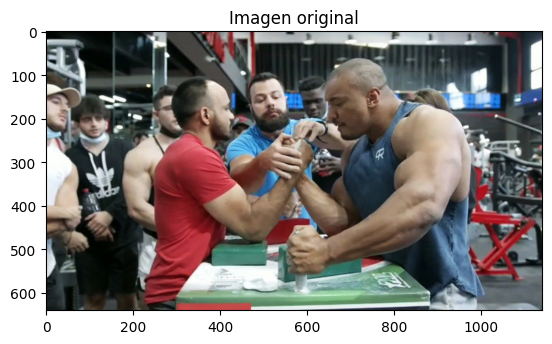

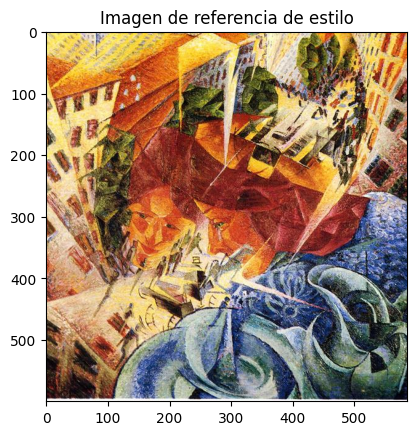

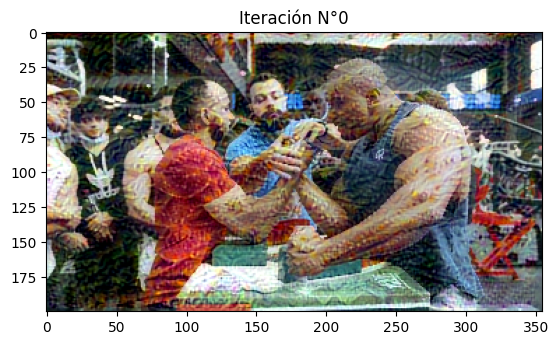

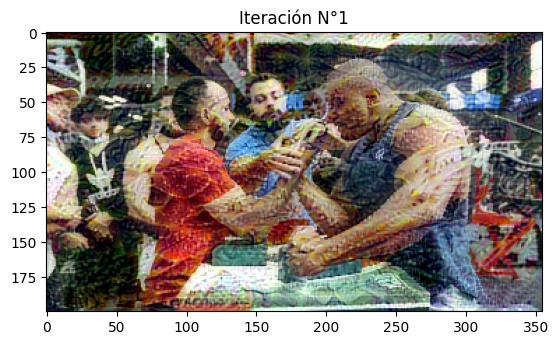

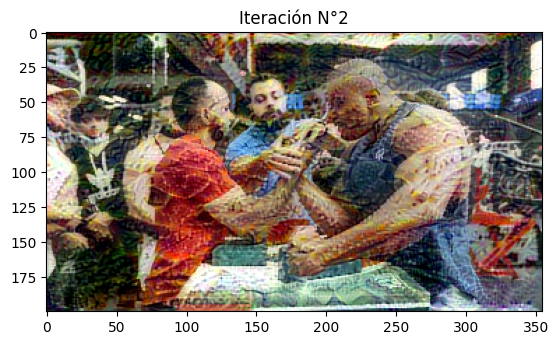

...

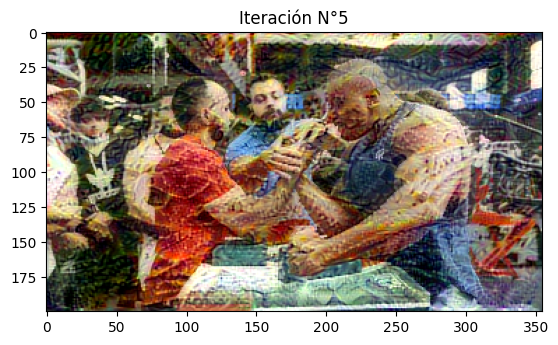

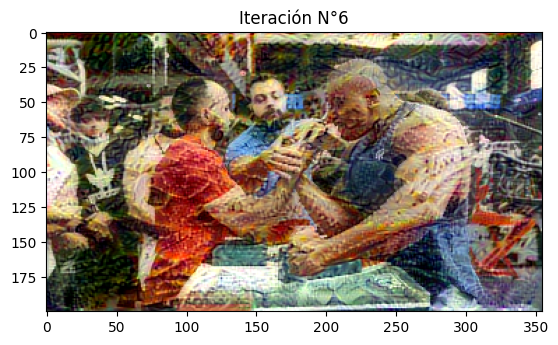

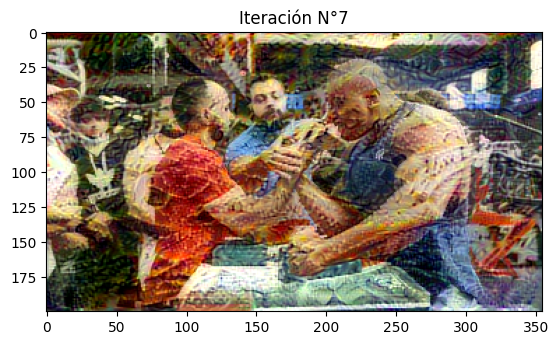

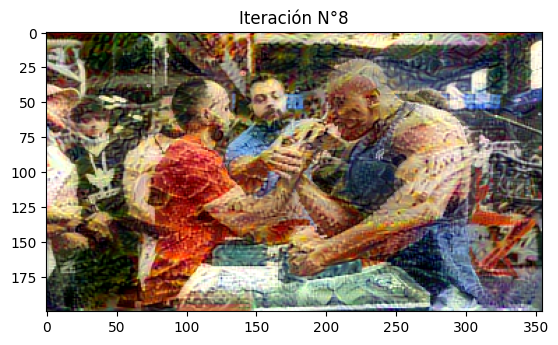

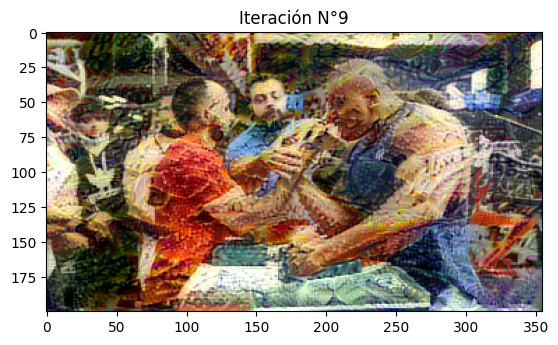

In [ ]:
# original
img_original = mpimg.imread('/content/pulseada.jpg')
plt.imshow(img_original)
plt.title("Imagen original")
plt.show()

# referencia
img_style = mpimg.imread('/content/futurismo.jpg')
plt.imshow(img_style)
plt.title("Imagen de referencia de estilo")
plt.show()

for i in range(iterations):
  img_output = mpimg.imread(str(result_prefix / ('output_at_iteration_%d.png' % i)))
  plt.imshow(img_output)
  plt.title(f"Iteración N°{i}")
  plt.show()

# Descarga

In [ ]:
!zip -r /content/all_outputs.zip /content/output /content/output_a /content/output_b /content/775px-Neckarfront_Tübingen_Mai_2017.jpg /content/La_noche_estrellada1.jpg /content/vacas.jpg /content/relojes.jpg /content/pulseada.jpg /content/futurismo.jpg

  adding: content/output/ (stored 0%)
  adding: content/output/output_combination_3_iteration_3.png (deflated 0%)
  adding: content/output/output_combination_1_iteration_3.png (deflated 0%)
  adding: content/output/.ipynb_checkpoints/ (stored 0%)
  adding: content/output/output_at_iteration_5.png (deflated 0%)
  adding: content/output/output_combination_2_iteration_1.png (deflated 0%)
  adding: content/output/output_at_iteration_9.png (deflated 0%)
  adding: content/output/output_at_iteration_1.png (deflated 0%)
  adding: content/output/output_at_iteration_7.png (deflated 0%)
  adding: content/output/output_combination_1_iteration_4.png (deflated 0%)
  adding: content/output/output_combination_2_iteration_0.png (deflated 0%)
  adding: content/output/output_combination_2_iteration_3.png (deflated 0%)
  adding: content/output/output_combination_2_iteration_4.png (deflated 0%)
  adding: content/output/output_at_iteration_6.png (deflated 0%)
  adding: content/output/output_combination_3_it

.zip con todas las imágenes subido a sourceforge: https://sourceforge.net/projects/dsp-fpga-dip-nn-itba/files/nn/tp1-images_n_outputs.zip/download